In [ ]:
!pip install kagglehub --upgrade


In [ ]:
from google.colab import files
files.upload()  # Upload your kaggle.json file


Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"rahilco","key":"bfc59f16d16ef95041b15edf2a6ae1e9"}'}

In [ ]:
!mkdir ~/.kaggle

In [ ]:
!cp /content/drive/MyDrive/kaggle.json ~/.kaggle/kaggle.json

In [ ]:
!chmod 600 ~/.kaggle/kaggle.json

In [ ]:
# Download the dataset ZIP to current directory
!kaggle datasets download -d itguides/pupil-eye-and-iris-segmentation

# Unzip to a known folder
!unzip pupil-eye-and-iris-segmentation.zip -d iris_dataset

# Check the contents
!ls iris_dataset


Dataset URL: https://www.kaggle.com/datasets/itguides/pupil-eye-and-iris-segmentation
License(s): MIT
 61% 89.0M/145M [00:00<00:00, 928MB/s]
100% 145M/145M [00:00<00:00, 862MB/s] 
Archive:  pupil-eye-and-iris-segmentation.zip
  inflating: iris_dataset/IRIS + PUPIL + EYE/train/image/0213_2_1_2_53_006.png  
  inflating: iris_dataset/IRIS + PUPIL + EYE/train/image/0214_1_1_2_20_003.png  
  inflating: iris_dataset/IRIS + PUPIL + EYE/train/image/0214_1_1_2_32_001.png  
  inflating: iris_dataset/IRIS + PUPIL + EYE/train/image/0214_1_1_2_32_003.png  
  inflating: iris_dataset/IRIS + PUPIL + EYE/train/image/0214_1_1_2_34_002.png  
  inflating: iris_dataset/IRIS + PUPIL + EYE/train/image/0214_1_1_2_52_003.png  
  inflating: iris_dataset/IRIS + PUPIL + EYE/train/image/0214_1_1_2_53_001.png  
  inflating: iris_dataset/IRIS + PUPIL + EYE/train/image/0214_2_1_2_20_000.png  
  inflating: iris_dataset/IRIS + PUPIL + EYE/train/image/0214_2_1_2_24_002.png  
  inflating: iris_dataset/IRIS + PUPIL + EYE/

In [ ]:
# Unzip to a known folder
!unzip pupil-eye-and-iris-segmentation.zip -d iris_dataset

Archive:  pupil-eye-and-iris-segmentation.zip
replace iris_dataset/IRIS + PUPIL + EYE/train/image/0213_2_1_2_53_006.png? [y]es, [n]o, [A]ll, [N]one, [r]ename: N


In [ ]:
import os
import numpy as np

from skimage.io import imread, imshow
from skimage.transform import resize
import matplotlib.pyplot as plt
from tqdm import tqdm



dataset="/content/pupil-eye-and-iris-segmentation.zip"
TRAIN_IMG_PATH= '/content/iris_dataset/IRIS + PUPIL + EYE/train/image'
TRAIN_MASK_PATH='/content/iris_dataset/IRIS + PUPIL + EYE/train/segmentation'
TEST_IMG_PATH='/content/iris_dataset/IRIS + PUPIL + EYE/val/image'
TEST_MASK_PATH='/content/iris_dataset/IRIS + PUPIL + EYE/val/segmentation'
train_img_ids = next(os.walk(TRAIN_IMG_PATH))[2]
train_mask_ids = next(os.walk(TRAIN_MASK_PATH))[2]

test_img_ids=next(os.walk(TEST_IMG_PATH))[2]
test_mask_ids=next(os.walk(TEST_MASK_PATH))[2]

In [ ]:
import tensorflow as tf
import os




IMG_WIDTH=128
IMG_HEIGHT=128
IMG_CHANNEL=1    # 3 for RGB IMAGE



data_dir = "/content/iris_dataset"
image_size = (128, 128)

# Load images (modify as needed for mask/image structure)
dataset = tf.keras.utils.image_dataset_from_directory(
    data_dir,
    image_size=image_size,
    batch_size=32,
    label_mode=None  # Use 'categorical' or 'binary' if labels exist
)


Found 2550 files.


In [ ]:
X_train=np.zeros((len(train_img_ids),IMG_HEIGHT,IMG_WIDTH,IMG_CHANNEL),dtype=np.uint8)
Y_train=np.zeros((len(train_mask_ids),IMG_HEIGHT,IMG_WIDTH,IMG_CHANNEL),dtype=np.bool)

print("Resize training images and masks")
train_img_files=[f for f in os.listdir(TRAIN_IMG_PATH) if f.endswith(".png")]
print(len(train_img_files))

# for n,id_ in tqdm(enumerate(train_img_ids), total=len(train_img_ids)):
#   path=TRAIN_IMG_PATH+id_
#   img=imread(path+'.png')[:,:,:IMG_CHANNEL]
#   img=resize(img,(IMG_HEIGHT, IMG_WIDTH,1),mode='constant',perserve_range=True)
#   X_train[n]=img
#   mask=np.zeros((IMG_HEIGHT,IMG_WIDTH,1),dtype=np.bool)

for i, filename in tqdm(enumerate(train_img_files), total=len(train_img_files)):
    img_path = os.path.join(TRAIN_IMG_PATH, filename)
    mask_path = os.path.join(TRAIN_MASK_PATH, filename)

    # Load image
    img = imread(img_path)

    # Handle 2D (grayscale)
    if img.ndim == 2:
        img = np.expand_dims(img, axis=-1)

    # Handle RGBA
    elif img.shape[2] == 4:
        img = img[:, :, :3]

    # Convert RGB to 1 channel if needed
    if IMG_CHANNEL == 1 and img.shape[2] == 3:
        img = np.expand_dims(img[:, :, 0], axis=-1)

    # Resize image
    img = resize(img, (IMG_HEIGHT, IMG_WIDTH, IMG_CHANNEL), mode='constant', preserve_range=True)
    X_train[i] = img.astype(np.uint8)

    # Load and resize mask
    mask = imread(mask_path, as_gray=True)
    mask = resize(mask, (IMG_HEIGHT, IMG_WIDTH), mode='constant', preserve_range=True)
    mask = np.expand_dims(mask > 0.5, axis=-1)
    Y_train[i] = mask


test_img_files=[f for f in os.listdir(TEST_IMG_PATH) if f.endswith(".png")]

X_test=np.zeros((len(test_img_files),IMG_HEIGHT,IMG_WIDTH,IMG_CHANNEL),dtype=np.uint8)
for n,files in tqdm(enumerate(test_img_files), total=len(test_img_files)):
  test_path=os.path.join(TEST_IMG_PATH, files)
  # Load image
  test_img = imread(test_path)

  # Handle 2D (grayscale)
  if test_img.ndim == 2:
      test_img = np.expand_dims(test_img, axis=-1)

  # Handle RGBA
  elif test_img.shape[2] == 4:
      test_img = test_img[:, :, :3]

  # Convert RGB to 1 channel if needed
  if IMG_CHANNEL == 1 and test_img.shape[2] == 3:
      test_img = np.expand_dims(test_img[:, :, 0], axis=-1)

  # Resize image
  test_img = resize(test_img, (IMG_HEIGHT, IMG_WIDTH, IMG_CHANNEL), mode='constant', preserve_range=True)
  X_test[n] = test_img.astype(np.uint8)

Resize training images and masks
1000


100%|██████████| 275/275 [00:06<00:00, 41.75it/s]


In [ ]:
print(f"X_train{len(X_train)}Y_train{len(Y_train)}")
min_len=min(len(X_train),len(Y_train))
X_train=X_train[:min_len]
Y_train=Y_train[:min_len]

print(f"AFTER MIN LENGTH\nX_train{len(X_train)} Y_train {len(Y_train)}")


X_train1000Y_train1000
AFTER MIN LENGTH
X_train1000 Y_train 1000


In [ ]:
import tensorflow as tf

IMG_WIDTH=128
IMG_HEIGHT=128
IMG_CHANNEL=1

#ENCODER
#input layer
inputs=tf.keras.layers.Input((IMG_WIDTH,IMG_HEIGHT,IMG_CHANNEL))
#Layer 1
##lambda function
s=tf.keras.layers.Lambda(lambda x:x/255)(inputs)

##Convulation layer 1
c1=tf.keras.layers.Conv2D(16,(3,3),activation='relu',kernel_initializer='he_normal',padding='same')(s)

##Dropout layer
c1=tf.keras.layers.Dropout(0.1)(c1)  #dropping 10% of layers to avoide overfitting
c1=tf.keras.layers.Conv2D(16,(3,3),activation='relu',kernel_initializer='he_normal',padding='same')(c1)

##maxpooling layer 1
p1=tf.keras.layers.MaxPooling2D((2,2))(c1)


#layer 2
##conv layer 2
c2=tf.keras.layers.Conv2D(32,(3,3),activation='relu',kernel_initializer='he_normal',padding='same')(p1) #applies conv2d on the max pooling layer from the layer 1
c2=tf.keras.layers.Dropout(0.1)(c2)
c2=tf.keras.layers.Conv2D(32,(3,3),activation='relu',kernel_initializer='he_normal',padding='same')(c2)
##maxpooling layer 2
p2=tf.keras.layers.MaxPooling2D((2,2))(c2)

#layer3
c3=tf.keras.layers.Conv2D(64,(3,3),activation='relu',kernel_initializer='he_normal',padding='same')(p2) #applies conv2d on the max pooling layer from the layer 2
c3=tf.keras.layers.Dropout(0.2)(c3)
c3=tf.keras.layers.Conv2D(64,(3,3),activation='relu',kernel_initializer='he_normal',padding='same')(c3)
p3=tf.keras.layers.MaxPooling2D((2,2))(c3)

#layer 4
c4=tf.keras.layers.Conv2D(128,(3,3),activation='relu',kernel_initializer='he_normal',padding='same')(p3) #applies conv2d on the max pooling layer from the layer 3

c4=tf.keras.layers.Dropout(0.2)(c4)
c4=tf.keras.layers.Conv2D(128,(3,3),activation='relu',kernel_initializer='he_normal',padding='same')(c4)
p4=tf.keras.layers.MaxPooling2D((2,2))(c4)

c5=tf.keras.layers.Conv2D(256,(3,3),activation='relu',kernel_initializer='he_normal',padding='same')(p4)
c5=tf.keras.layers.Dropout(0.3)(c5)
c5=tf.keras.layers.Conv2D(256,(3,3),activation='relu',kernel_initializer='he_normal',padding='same')(c5)



#DECODER

#Decoder layer 1
u6=tf.keras.layers.Conv2DTranspose(128,(2,2),strides=(2,2),padding='same')(c5)
u6=tf.keras.layers.concatenate([u6,c4])
c6=tf.keras.layers.Conv2D(128,(3,3),activation='relu',kernel_initializer='he_normal',padding='same')(u6)
c6=tf.keras.layers.Dropout(0.2)(c6)
c6=tf.keras.layers.Conv2D(128,(3,3),activation='relu',kernel_initializer='he_normal',padding='same')(c6)

u7=tf.keras.layers.Conv2DTranspose(64,(2,2),strides=(2,2),padding='same')(c6)
u7=tf.keras.layers.concatenate([u7,c3])
c7=tf.keras.layers.Conv2D(64,(3,3),activation='relu',kernel_initializer='he_normal',padding='same')(u7)
c7=tf.keras.layers.Dropout(0.2)(c7)
c7=tf.keras.layers.Conv2D(64,(3,3),activation='relu',kernel_initializer='he_normal',padding='same')(c7)

u8=tf.keras.layers.Conv2DTranspose(32,(2,2),strides=(2,2),padding='same')(c7)
u8=tf.keras.layers.concatenate([u8,c2])
c8=tf.keras.layers.Conv2D(32,(3,3),activation='relu',kernel_initializer='he_normal',padding='same')(u8)
c8=tf.keras.layers.Dropout(0.1)(c8)
c8=tf.keras.layers.Conv2D(32,(3,3),activation='relu',kernel_initializer='he_normal',padding='same')(c8)

u9=tf.keras.layers.Conv2DTranspose(16,(2,2),strides=(2,2),padding='same')(c8)
u9=tf.keras.layers.concatenate([u9,c1])
c9=tf.keras.layers.Conv2D(16,(3,3),activation='relu',kernel_initializer='he_normal',padding='same')(u9)
c9=tf.keras.layers.Dropout(0.1)(c9)
c9=tf.keras.layers.Conv2D(16,(3,3),activation='relu',kernel_initializer='he_normal',padding='same')(c9)

#OUTPUT
outputs=tf.keras.layers.Conv2D(1,(1,1),activation='sigmoid')(c9)


#MODEL

model=tf.keras.Model(inputs=[inputs],outputs=[outputs])
model.compile(optimizer='adam',loss='binary_crossentropy',metrics=['accuracy'])
model.summary()













Model: "functional_3"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_3       │ (None, 128, 128,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ lambda_3 (Lambda)   │ (None, 128, 128,  │          0 │ input_layer_3[0]… │
│                     │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_57 (Conv2D)  │ (None, 128, 128,  │        160 │ lambda_3[0][0]    │
│                     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_27          │ (None, 128, 128,  │          0 │ conv2d_57[0][0]   │
│ (Dropout)           │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_58 (Conv2D)  │ (None, 128, 128,  │      2,320 │ dropout_27[0][0]  │
│                     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_12    │ (None, 64, 64,    │          0 │ conv2d_58[0][0]   │
│ (MaxPooling2D)      │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_59 (Conv2D)  │ (None, 64, 64,    │      4,640 │ max_pooling2d_12… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_28          │ (None, 64, 64,    │          0 │ conv2d_59[0][0]   │
│ (Dropout)           │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_60 (Conv2D)  │ (None, 64, 64,    │      9,248 │ dropout_28[0][0]  │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_13    │ (None, 32, 32,    │          0 │ conv2d_60[0][0]   │
│ (MaxPooling2D)      │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_61 (Conv2D)  │ (None, 32, 32,    │     18,496 │ max_pooling2d_13… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_29          │ (None, 32, 32,    │          0 │ conv2d_61[0][0]   │
│ (Dropout)           │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_62 (Conv2D)  │ (None, 32, 32,    │     36,928 │ dropout_29[0][0]  │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_14    │ (None, 16, 16,    │          0 │ conv2d_62[0][0]   │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_63 (Conv2D)  │ (None, 16, 16,    │     73,856 │ max_pooling2d_14… │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_30          │ (None, 16, 16,    │          0 │ conv2d_63[0][0]   │
│ (Dropout)           │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_64 (Conv2D)  │ (None, 16, 16,    │    147,584 │ dropout_30[0][0]

 Total params: 1,940,817 (7.40 MB)

 Trainable params: 1,940,817 (7.40 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
#model checkpoint
checkpointer=tf.keras.callbacks.ModelCheckpoint('model_for_nuclei.h5',verbose =1,save_best_only=True)
callbacks=[
    tf.keras.callbacks.EarlyStopping(patience=2,monitor='val_loss'),
    tf.keras.callbacks.TensorBoard(log_dir='logs')
]
result=model.fit(X_train,Y_train,validation_split=0.1,batch_size=16,epochs=25, callbacks=callbacks)


Epoch 1/25
57/57 ━━━━━━━━━━━━━━━━━━━━ 183s 3s/step - accuracy: 0.7486 - loss: 0.4551 - val_accuracy: 0.9024 - val_loss: 0.2504
Epoch 2/25
57/57 ━━━━━━━━━━━━━━━━━━━━ 171s 3s/step - accuracy: 0.9023 - loss: 0.2286 - val_accuracy: 0.8958 - val_loss: 0.2611
Epoch 3/25
57/57 ━━━━━━━━━━━━━━━━━━━━ 199s 3s/step - accuracy: 0.9208 - loss: 0.1840 - val_accuracy: 0.9213 - val_loss: 0.1879
Epoch 4/25
57/57 ━━━━━━━━━━━━━━━━━━━━ 224s 3s/step - accuracy: 0.9358 - loss: 0.1502 - val_accuracy: 0.9352 - val_loss: 0.1613
Epoch 5/25
57/57 ━━━━━━━━━━━━━━━━━━━━ 197s 3s/step - accuracy: 0.9426 - loss: 0.1349 - val_accuracy: 0.9445 - val_loss: 0.1313
Epoch 6/25
57/57 ━━━━━━━━━━━━━━━━━━━━ 183s 3s/step - accuracy: 0.9484 - loss: 0.1224 - val_accuracy: 0.9437 - val_loss: 0.1347
Epoch 7/25
57/57 ━━━━━━━━━━━━━━━━━━━━ 166s 3s/step - accuracy: 0.9527 - loss: 0.1121 - val_accuracy: 0.9383 - val_loss: 0.1460


In [ ]:
preds_train=model.predict(X_train[:int(X_train.shape[0]*0.9)],verbose=1)
preds_val=model.predict(X_train[:int(X_train.shape[0]*0.9)],verbose=1)
preds_test=model.predict(X_test,verbose=1)


29/29 ━━━━━━━━━━━━━━━━━━━━ 39s 1s/step
29/29 ━━━━━━━━━━━━━━━━━━━━ 40s 1s/step
9/9 ━━━━━━━━━━━━━━━━━━━━ 13s 1s/step


In [ ]:
predict_train_t=(preds_train>0.5).astype(np.uint8)
predict_val_t=(preds_val>0.5).astype(np.uint8)
predict_test_t=(preds_test>0.5).astype(np.uint8)



In [ ]:
import tensorflow as tf

def dice_metric(y_true, y_pred):
    y_pred = tf.round(y_pred)
    intersection = tf.reduce_sum(y_true * y_pred)
    return (2. * intersection) / (tf.reduce_sum(y_true) + tf.reduce_sum(y_pred) + 1e-7)


In [ ]:
import matplotlib.pyplot as plt

def display_sample(index, X, Y_true, Y_pred):
    """
    index: Index of the sample to display
    X: Input image batch
    Y_true: Ground truth mask
    Y_pred: Predicted mask (thresholded)
    """
    fig, ax = plt.subplots(1, 3, figsize=(15, 5))

    # Input image
    ax[0].imshow(X[index].squeeze(), cmap='gray')
    ax[0].set_title("Input Image")

    # Ground truth
    ax[1].imshow(Y_true[index].squeeze(), cmap='gray')
    ax[1].set_title("Ground Truth Mask")

    # Prediction
    ax[2].imshow(Y_pred[index].squeeze(), cmap='gray')
    ax[2].set_title("Predicted Mask")

    for a in ax:
        a.axis('off')

    plt.tight_layout()
    plt.show()


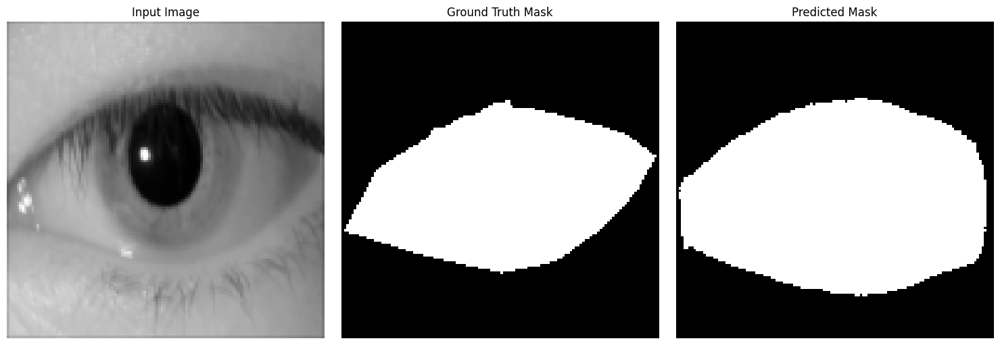

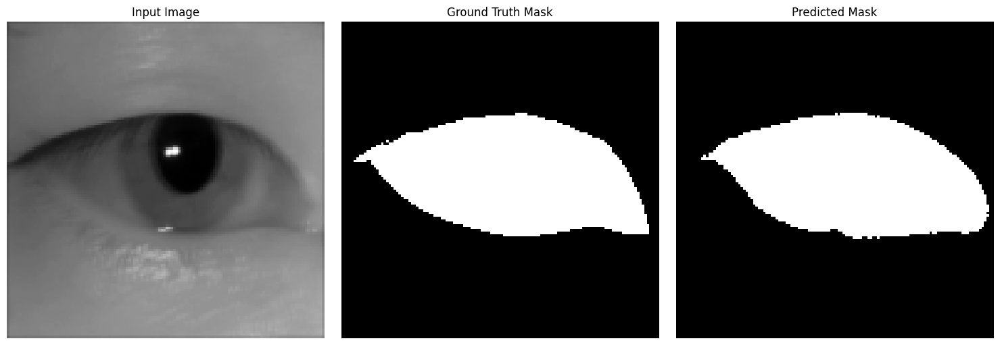

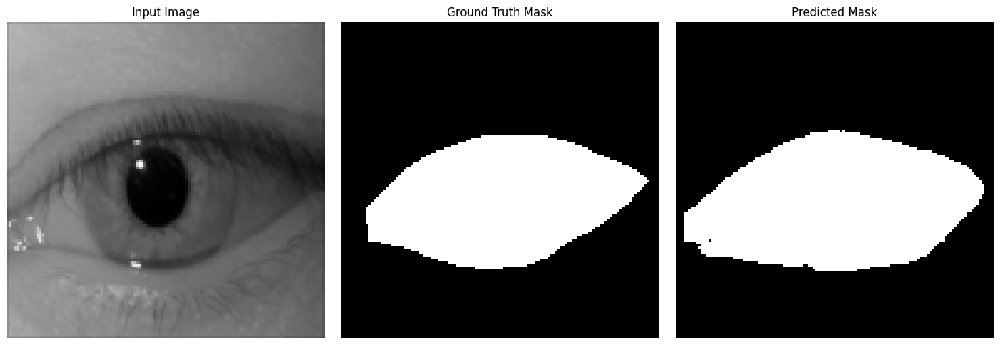

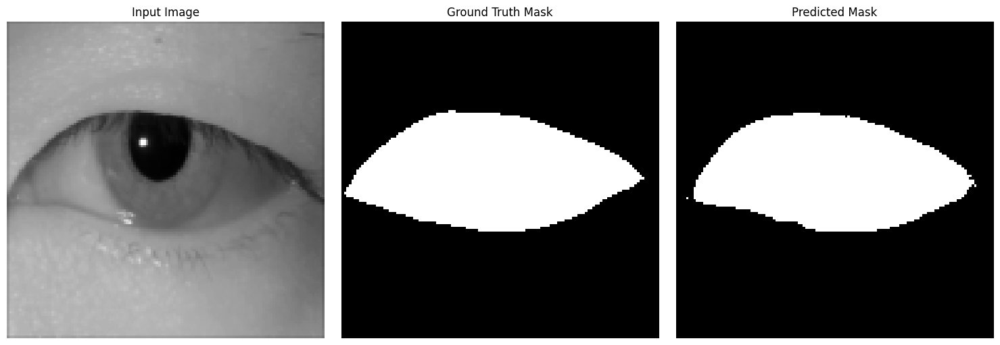

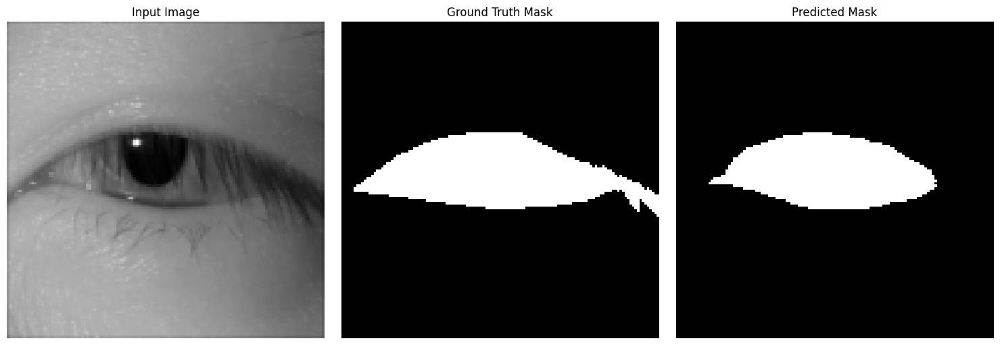

...

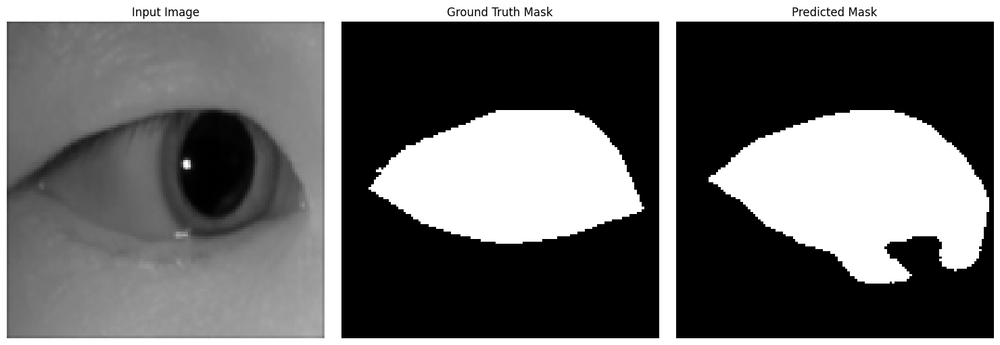

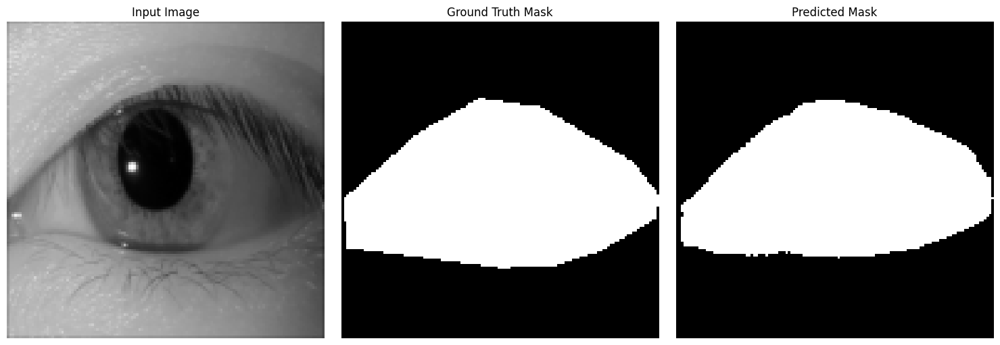

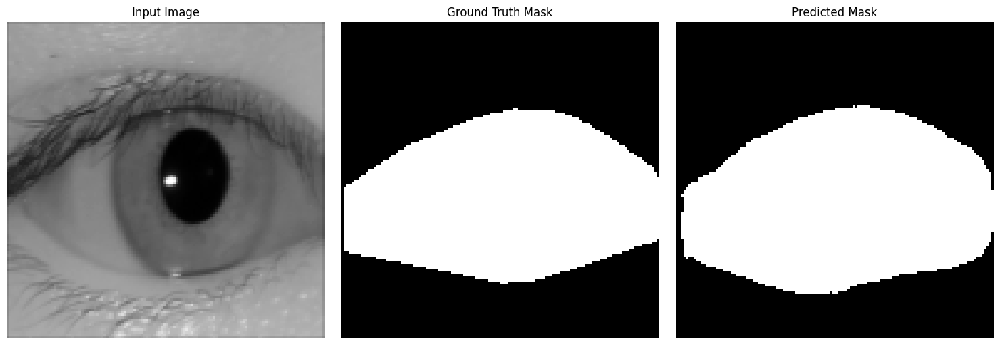

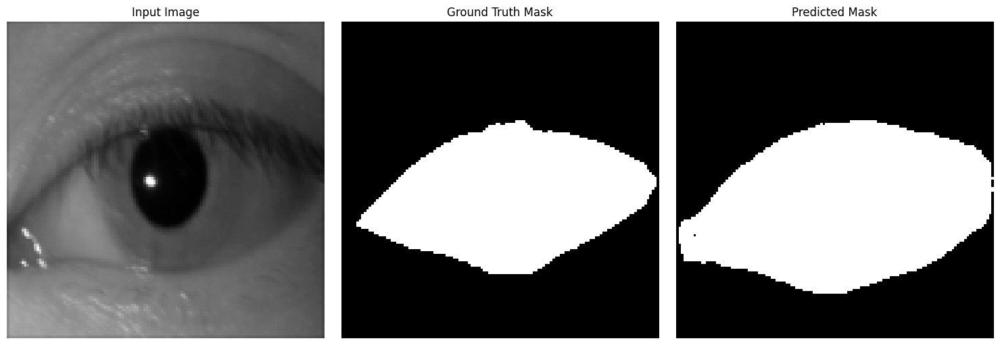

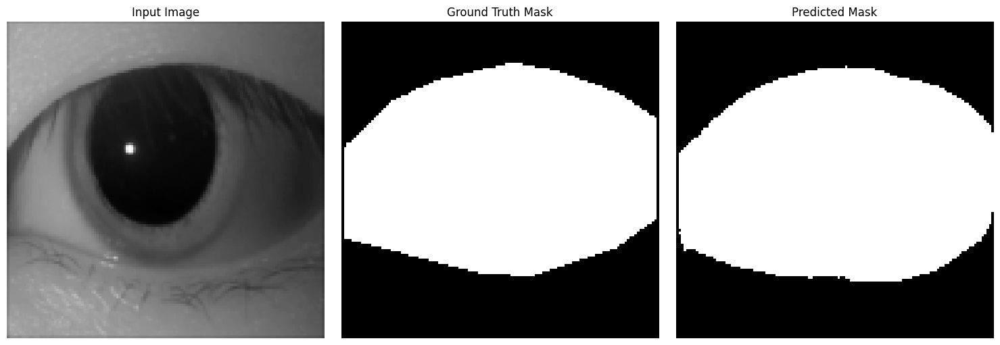

IndexError: index 900 is out of bounds for axis 0 with size 900

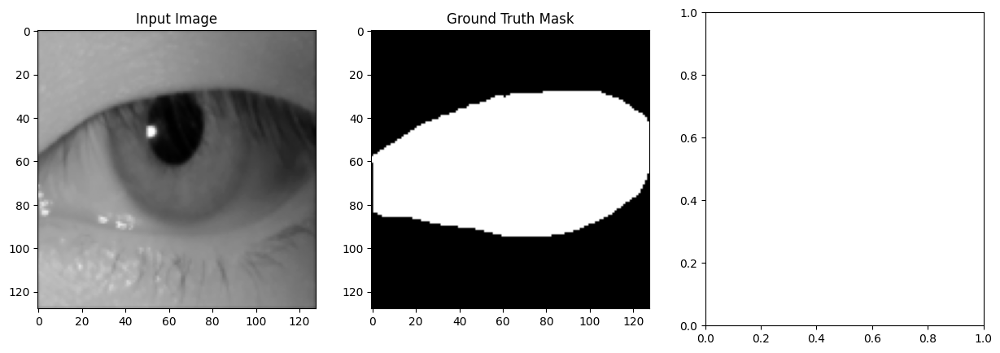

In [ ]:
# Example: visualize the 5th training image prediction
display_sample(4, X_train, Y_train, predict_train_t)
for i in range(len(X_train)):
    display_sample(i, X_train, Y_train, predict_train_t)


In [ ]:
def overlay_mask(image, mask, color=(0, 255, 0), alpha=0.4):
    """Overlay binary mask on grayscale or RGB image with transparency."""
    # Ensure image is 3 channels
    if image.ndim == 2 or image.shape[2] == 1:
        image_rgb = np.repeat(image.squeeze()[..., np.newaxis], 3, axis=-1)
    else:
        image_rgb = image.copy()

    image_rgb = image_rgb.astype(np.float32)
    mask_bool = mask.squeeze().astype(bool)

    # Apply overlay
    overlay = image_rgb.copy()
    overlay[mask_bool] = overlay[mask_bool] * (1 - alpha) + np.array(color) * alpha
    return overlay.astype(np.uint8)


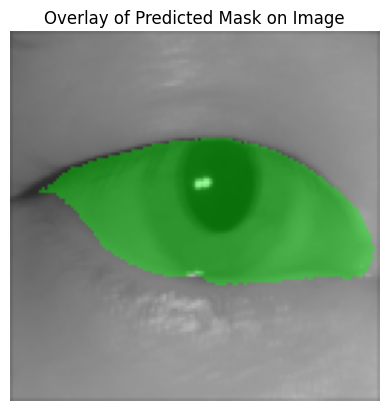

In [ ]:
image = X_train[0]
mask = predict_train_t[0]

overlay = overlay_mask(image, mask)

plt.imshow(overlay)
plt.title("Overlay of Predicted Mask on Image")
plt.axis("off")
plt.show()
